# Este notebook realiza la comparación para resolver el issue #20:
# Mini EDA de respuestas con URL inválido en columna ARCHIVO

Cada registro en la solicitud tiene una columna ARCHIVO donde hay un URL de donde se puede descargar un adjunto que enriquece (o no) la respuesta.

Algunos de estos URLs son inválidos, inexistentes, retornan adjuntos vacíos, ZIP vacíos, o solo regresan una página en blanco.

Se pide realizar mini EDA de estos casos en particular para responder lo siguiente:

Hay un patrón claro de adjuntos que van desapareciendo en el tiempo, o la cantidad de adjuntos invalidos es aproximadamente la misma en todos los años?
Existe alguna concentración de adjuntos erróneos en alguna dependencia?

**A DISCUSIÓN:** finalizar con la adición del feature calidad_adjunto, donde se le asigna un 1 si tiene un adjunto descargable o accesible, y -1 si es un URL inválido.

In [1]:
import boto3
import pyarrow
import datetime
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
f = f's3://inai-summerofdata/parquet/inai.parquet'
df = pd.read_parquet(f, engine='pyarrow')
df.head()

,FOLIO,FECHASOLICITUD,DEPENDENCIA,ESTATUS,MEDIOENTRADA,TIPOSOLICITUD,DESCRIPCIONSOLICITUD,OTROSDATOS,ARCHIVOADJUNTOSOLICITUD,MEDIOENTREGA,...,TEXTORESPUESTA,ARCHIVORESPUESTA,FECHARESPUESTA,PAIS,ESTADO,MUNICIPIO,CODIGOPOSTAL,SECTOR,tipo_archivo_respuesta,cantidad_archivos_respuesta
0,1857500001912,2012/01/01 05:04:07,PEMEX EXPLORACIÓN Y PRODUCCIÓN,Terminada,Electrónica,Información Pública,Copia de los documentos y los datos con que cu...,None,None,Entrega por Internet en el INFOMEX,...,Se anexa archivo con la respuesta a la informa...,https://www.infomex.org.mx/gobiernofederal/mod...,2012/03/02,México,Distrito Federal,BENITO JUAREZ,3100,Energía,pdf,1.0
1,1857500002012,2012/01/01 05:13:16,PEMEX EXPLORACIÓN Y PRODUCCIÓN,Terminada,Electrónica,Información Pública,Del ATG para precisar información y datos usa...,None,None,Entrega por Internet en el INFOMEX,...,Se anexa archivo con la respuesta a la informa...,https://www.infomex.org.mx/gobiernofederal/mod...,2012/03/02,México,Distrito Federal,BENITO JUAREZ,3100,Energía,pdf,1.0
2,1800000712,2012/01/01 09:46:39,SECRETARÍA DE ENERGÍA,Terminada,Electrónica,Información Pública,Agradeceré se me proporcione en archivo magnét...,None,None,Entrega por Internet en el INFOMEX,...,EL ASUNTO SE TURNÓ A LA DIRECCIÓN GENERAL DE R...,https://www.infomex.org.mx/gobiernofederal/mod...,2012/02/02,México,Distrito Federal,MIGUEL HIDALGO,11230,Energía,zip,2.0
3,600003712,2012/01/01 10:11:41,SECRETARÍA DE HACIENDA Y CRÉDITO PÚBLICO,Terminada,Electrónica,Información Pública,Agradeceré se me proporcione en archivo magnét...,None,None,Entrega por Internet en el INFOMEX,...,Direcci&oacute;n de Internet en donde se encue...,https://www.infomex.org.mx/gobiernofederal/mod...,2012/02/02,México,Distrito Federal,MIGUEL HIDALGO,11230,Hacienda y Crédito Público,pdf,1.0
4,1500002812,2012/01/01 10:32:15,SECRETARÍA DE DESARROLLO AGRARIO TERRITORIAL ...,Terminada,Electrónica,Información Pública,Agradeceré se me proporcione en archivo magnét...,None,None,Entrega por Internet en el INFOMEX,...,None,https://www.infomex.org.mx/gobiernofederal/mod...,2012/02/01,México,Distrito Federal,MIGUEL HIDALGO,11230,Reforma Agraria,zip,4.0


Hacemos las categorías de `ARCHIVORESPUESTA`

In [77]:
#nulo = 0
#for element in df['category_url']:
#    df.loc[df["ARCHIVORESPUESTA"] == "https", "ARCHIVORESPUESTA"] = 'URL'    
#    if element.isnull():
#        nulo = 0
#    else: 
#        if element.astype(str).contains('http'):
#            #df["category_url"][df['ARCHIVORESPUESTA'].str.contains("http")] = "url"
#            df.loc[element, "ARCHIVORESPUESTA"] = 'URL'

#df.sample()
    

In [69]:
#df.loc[df["ARCHIVORESPUESTA"] == "https", "ARCHIVORESPUESTA"] = 'URL'
#df = pd.DataFrame(df)
#df['category_url'] = np.where([df['category_url'].str.contains('https', case=False),"URL"])
#df["category_url"] = ["URL" if ele == 'http' else ele for ele in df["ARCHIVORESPUESTA"]] # .str.contains('https', case=False)

#df['Category'] = np.select([df['ARCHIVORESPUESTA'].str.contains('https', case=False))
#df.loc[df["category_url"].str.contains('https', case=False, na=None), "category_url"] = 'URL'


#df['category_url'] = df["ARCHIVORESPUESTA"]
#df["category_url"][df['ARCHIVORESPUESTA'].str.contains("http")] = "url"
#df.sample(10)
                                                   

<ipython-input-69-87dc0e6b426b>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["category_url"][df['ARCHIVORESPUESTA'].str.contains("http")] = "url"


ValueError: Cannot mask with non-boolean array containing NA / NaN values

En primer lugar, extraemos los valores que nos interesan:

In [17]:
df_filtrado1 = df[df['tipo_archivo_respuesta'].isna()]
df_filtrado2 = df[df['tipo_archivo_respuesta']=='zip']
df_filtrado3 = df[df['tipo_archivo_respuesta']=='ZIP']
df_filtrado4 = df_filtrado2.append(df_filtrado3)
df_filtrado5 = df[df['cantidad_archivos_respuesta']==0]
df_filtrado = df_filtrado1.append(df_filtrado5)
len(df_filtrado)

576237

En total, tenemos esta cantidad de renglones que no tienen un pdf o archivo utilizable:

In [21]:
len(df_filtrado)

576237

In [24]:
num_por_tipos = df_filtrado['tipo_archivo_respuesta'].value_counts(dropna=False)
#num_por_tipos
num_por_tipos_df = pd.DataFrame(data=num_por_tipos)
num_por_tipos_df['porcentaje'] = df_filtrado['tipo_archivo_respuesta'].value_counts(dropna=False, normalize=True).mul(100).round(2).astype(str)+'%'
num_por_tipos_df

,tipo_archivo_respuesta,porcentaje
NaN,576218,100.0%
zip,19,0.0%


In [19]:
for col in ['FECHASOLICITUD', 'FECHARESPUESTA']:#, 'FECHALIMITE']:
    df_filtrado[col] = pd.to_datetime(df_filtrado[col],format= "%Y-%m-%d %H:%M:%S")

In [20]:
df_filtrado['año_solicitud'] = pd.DatetimeIndex(df_filtrado['FECHASOLICITUD']).year
df_filtrado.head()

,FOLIO,FECHASOLICITUD,DEPENDENCIA,ESTATUS,MEDIOENTRADA,TIPOSOLICITUD,DESCRIPCIONSOLICITUD,OTROSDATOS,ARCHIVOADJUNTOSOLICITUD,MEDIOENTREGA,...,ARCHIVORESPUESTA,FECHARESPUESTA,PAIS,ESTADO,MUNICIPIO,CODIGOPOSTAL,SECTOR,tipo_archivo_respuesta,cantidad_archivos_respuesta,año_solicitud
8,400002412,2012-01-01 11:33:14,SECRETARÍA DE GOBERNACIÓN (INCLUYE LA ENTONCES...,Terminada,Electrónica,Información Pública,Agradeceré se me proporciones en archivo magné...,None,None,Entrega por Internet en el INFOMEX,...,https://www.infomex.org.mx/gobiernofederal/mod...,2012-01-05,México,Distrito Federal,MIGUEL HIDALGO,11230,Gobernación,None,NaN,2012
9,800001412,2012-01-01 11:41:37,SECRETARÍA DE AGRICULTURA GANADERÍA DESARROL...,Terminada,Electrónica,Información Pública,Agradeceré se me proporciones en archivo magné...,None,None,Entrega por Internet en el INFOMEX,...,None,2012-01-09,México,Distrito Federal,MIGUEL HIDALGO,11230,"Agricultura, Ganadería, Desarrollo Rural, Pesc...",None,NaN,2012
10,800001512,2012-01-01 11:47:43,SECRETARÍA DE AGRICULTURA GANADERÍA DESARROL...,Terminada,Electrónica,Información Pública,Agradeceré se me proporciones en archivo magné...,None,None,Entrega por Internet en el INFOMEX,...,None,2012-01-09,México,Distrito Federal,MIGUEL HIDALGO,11230,"Agricultura, Ganadería, Desarrollo Rural, Pesc...",None,NaN,2012
11,64100066412,2012-01-01 11:59:27,INSTITUTO MEXICANO DEL SEGURO SOCIAL,Desechada por falta de respuesta del ciudadano,Electrónica,Datos Personales,DESCRIPCIÓN SOLICITUD,OTROS DATOS,None,Copia Simple,...,ADJUNTO,2012-01-16,México,Distrito Federal,XOCHIMILCO,16038,Aportaciones a Seguridad Social,None,NaN,2012
16,64100066612,2012-01-01 13:53:39,INSTITUTO MEXICANO DEL SEGURO SOCIAL,Terminada,Electrónica,Datos Personales,DESCRIPCIÓN SOLICITUD,OTROS DATOS,ADJUNTO SOLICITUD,Copia Certificada,...,ADJUNTO,2012-01-19,México,Puebla,IZUCAR DE MATAMOROS,74420,Aportaciones a Seguridad Social,None,NaN,2012


In [41]:
#df_filtrado.sample(9)

,FOLIO,FECHASOLICITUD,DEPENDENCIA,ESTATUS,MEDIOENTRADA,TIPOSOLICITUD,DESCRIPCIONSOLICITUD,OTROSDATOS,ARCHIVOADJUNTOSOLICITUD,MEDIOENTREGA,...,ARCHIVORESPUESTA,FECHARESPUESTA,PAIS,ESTADO,MUNICIPIO,CODIGOPOSTAL,SECTOR,tipo_archivo_respuesta,cantidad_archivos_respuesta,año_solicitud
275748,64100343716,2016-02-09 17:12:59,INSTITUTO MEXICANO DEL SEGURO SOCIAL,Terminada,Electrónica,Datos Personales,DESCRIPCIÓN SOLICITUD,OTROS DATOS,ADJUNTO SOLICITUD,Otro Medio,...,ADJUNTO,2016-02-11,México,Querétaro,QUERETARO,76116,Aportaciones a Seguridad Social,None,NaN,2016
1029840,64100011617,2016-12-20 13:17:52,INSTITUTO MEXICANO DEL SEGURO SOCIAL,Terminada,Electrónica,Datos Personales,DESCRIPCIÓN SOLICITUD,OTROS DATOS,None,Copia Simple,...,ADJUNTO,2017-01-04,México,México,TOLUCA,50260,Aportaciones a Seguridad Social,None,NaN,2016
1230434,1100500001718,2018-04-24 19:24:21,SEP-UNIVERSIDAD ABIERTA Y A DISTANCIA DE MÉXIC...,Desechada por falta de respuesta del ciudadano,Electrónica,Información Pública,Materia educativa,SEP universidad.,None,Entrega por Internet en la PNT,...,https://www.infomex.org.mx/gobiernofederal/mod...,2018-04-25,México,Ciudad de México,AZCAPOTZALCO,02400,Ninguno,None,NaN,2018
301089,900095616,2016-04-04 15:54:18,SECRETARÍA DE COMUNICACIONES Y TRANSPORTES,Terminada,Electrónica,Información Pública,1. ¿Los metrobus conforme a la Ley aplicable d...,Citar las Leyes especificando los artículos qu...,None,Entrega por Internet en la PNT,...,None,2016-04-08,México,Distrito Federal,COYOACAN,04369,Comunicaciones y Transportes,None,NaN,2016
687965,2100043413,2013-09-06 11:20:25,SECRETARÍA DE TURISMO,Desechada por falta de respuesta del ciudadano,Electrónica,Información Pública,México D.F. a 06 de septiembre de 2013. Lic....,None,None,Entrega por Internet en el INFOMEX,...,None,2013-10-14,México,Distrito Federal,BENITO JUAREZ,03200,Turismo,None,NaN,2013
1262800,64101552218,2018-06-14 09:21:44,INSTITUTO MEXICANO DEL SEGURO SOCIAL (IMSS),Desechada por falta de respuesta del ciudadano,Electrónica,Datos Personales,DESCRIPCIÓN SOLICITUD,OTROS DATOS,None,Copia Simple,...,ADJUNTO,2018-06-18,México,México,ECATEPEC,55000,Aportaciones a Seguridad Social,None,NaN,2018
1398411,1026500044919,2019-03-25 16:23:00,INSTITUTO MEXICANO DE LA PROPIEDAD INDUSTRIAL,Terminada,Electrónica,Información Pública,Versión pública del oficio del IMPI con fundam...,None,None,Entrega por Internet en la PNT,...,None,2019-06-14,México,Ciudad de México,VENUSTIANO CARRANZA,15000.0,Economía,None,NaN,2019
305597,1114100021016,2016-04-11 23:27:38,SECRETARIA DE CULTURA EN PROCESO DE REESTRUCT...,Desechada por falta de respuesta del ciudadano,Electrónica,Información Pública,Solicito todos los informes presentados por mu...,http://fonca.conaculta.gob.mx/wp-content/uploa...,None,Entrega por Internet en la PNT,...,None,2016-05-11,México,Distrito Federal,BENITO JUAREZ,03810,Educación Pública,None,NaN,2016
1173467,1857500132717,2017-10-10 13:28:43,PEMEX EXPLORACIÓN Y PRODUCCIÓN,Desechada por falta de pago,Electrónica,Información Pública,hola solicito el contrato de convenio con la u...,None,None,Entrega por Internet en la PNT,...,None,2017-11-10,México,Veracruz,VERACRUZ,91778.0,Energía,None,NaN,2017


#### Hay un patrón claro de adjuntos que van desapareciendo en el tiempo, o la cantidad de adjuntos invalidos es aproximadamente la misma en todos los años?

## Distribución de los archivos no utilizables por año

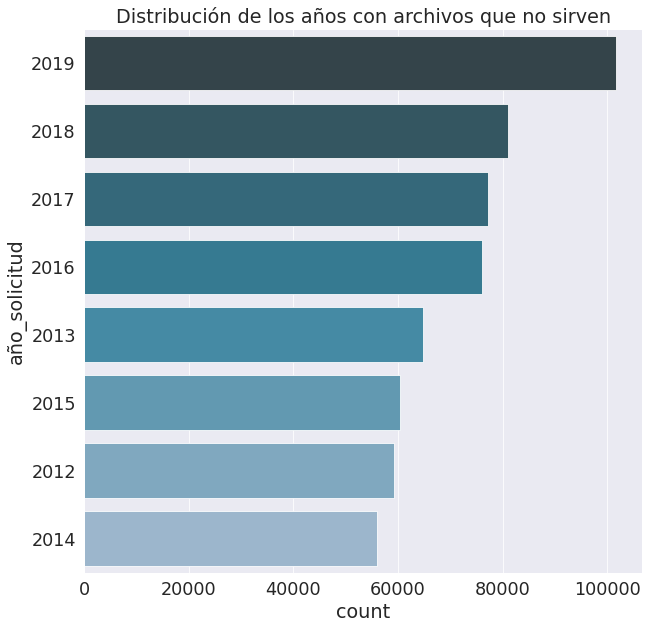

In [27]:
sns.set(style="darkgrid")
sns.set_context("paper", font_scale=2)     
plt.figure(figsize=(10, 10))
plt.title("Distribución de los años con archivos que no sirven")
ax = sns.countplot(y="año_solicitud", data=df_filtrado,order = df_filtrado['año_solicitud'].value_counts().index, palette="PuBuGn_d")

In [32]:
num_por_tipos = df_filtrado['año_solicitud'].value_counts(dropna=False)
#num_por_tipos
num_por_tipos_df = pd.DataFrame(data=num_por_tipos)
num_por_tipos_df['porcentaje'] = df_filtrado['año_solicitud'].value_counts(dropna=False, normalize=True).mul(100).round(2).astype(str)+'%'
num_por_tipos_df

,año_solicitud,porcentaje
2019,101596,17.63%
2018,81028,14.06%
2017,77172,13.39%
2016,75983,13.19%
2013,64725,11.23%
2015,60404,10.48%
2012,59313,10.29%
2014,56016,9.72%


Pero ¿en realidad está aumentando el número de solicitudes al año?

## Distribución de número de solicitudes por año

In [28]:
for col in ['FECHASOLICITUD', 'FECHARESPUESTA']:#, 'FECHALIMITE']:
    df[col] = pd.to_datetime(df[col],format= "%Y-%m-%d %H:%M:%S")

df['año_solicitud'] = pd.DatetimeIndex(df['FECHASOLICITUD']).year


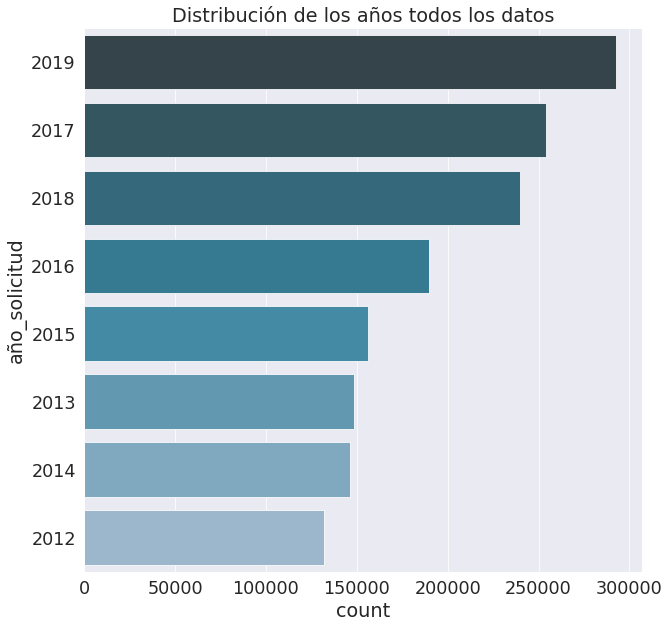

In [31]:
sns.set(style="darkgrid")
sns.set_context("paper", font_scale=2)     
plt.figure(figsize=(10, 10))
plt.title("Distribución de los años todos los datos")
ax = sns.countplot(y="año_solicitud", data=df,order = df['año_solicitud'].value_counts().index, palette="PuBuGn_d")

In [33]:
num_por_tipos = df['año_solicitud'].value_counts(dropna=False)
#num_por_tipos
num_por_tipos_df = pd.DataFrame(data=num_por_tipos)
num_por_tipos_df['porcentaje'] = df['año_solicitud'].value_counts(dropna=False, normalize=True).mul(100).round(2).astype(str)+'%'
num_por_tipos_df

,año_solicitud,porcentaje
2019,292335,18.75%
2017,253846,16.28%
2018,239923,15.39%
2016,189591,12.16%
2015,156183,10.02%
2013,148545,9.53%
2014,146449,9.39%
2012,132140,8.48%


Juntamos los archivos:

Conclusión: Vemos que se van concentrando en los años más recientes, pero tiene sentido por que se mantiene el porcentaje con respecto al año correspondiente.

#### Existe alguna concentración de adjuntos erróneos en alguna dependencia?

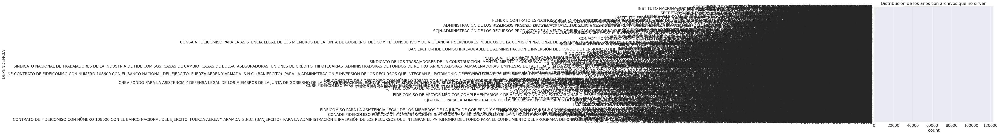

In [34]:
sns.set(style="darkgrid")
sns.set_context("paper", font_scale=2)     
plt.figure(figsize=(10, 10))
plt.title("Distribución de los años con archivos que no sirven")
ax = sns.countplot(y="DEPENDENCIA", data=df_filtrado,order = df_filtrado['DEPENDENCIA'].value_counts().index, palette="PuBuGn_d")

In [42]:
pd.set_option('display.max_rows', None)
num_por_tipos = df_filtrado['DEPENDENCIA'].value_counts(dropna=False)
#num_por_tipos
num_por_tipos_df = pd.DataFrame(data=num_por_tipos)
num_por_tipos_df['porcentaje'] = df_filtrado['DEPENDENCIA'].value_counts(dropna=False, normalize=True).mul(100).round(2).astype(str)+'%'
num_por_tipos_df.head()

,DEPENDENCIA,porcentaje
INSTITUTO MEXICANO DEL SEGURO SOCIAL,117251,20.35%
INSTITUTO MEXICANO DEL SEGURO SOCIAL (IMSS),71190,12.35%
INSTITUTO DE SEGURIDAD Y SERVICIOS SOCIALES DE LOS TRABAJADORES DEL ESTADO,30072,5.22%
COMISIÓN FEDERAL PARA LA PROTECCIÓN CONTRA RIESGOS SANITARIOS,14413,2.5%
SECRETARÍA DE EDUCACIÓN PÚBLICA,12689,2.2%


Pero ¿en realidad está aumentando el número de solicitudes al año?

## Distribución de número de solicitudes por año

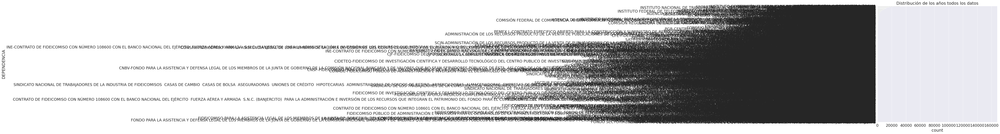

In [36]:
sns.set(style="darkgrid")
sns.set_context("paper", font_scale=2)     
plt.figure(figsize=(10, 10))
plt.title("Distribución de los años todos los datos")
ax = sns.countplot(y="DEPENDENCIA", data=df,order = df['DEPENDENCIA'].value_counts().index, palette="PuBuGn_d")

In [43]:
pd.set_option('display.max_rows', None)
num_por_tipos = df['DEPENDENCIA'].value_counts(dropna=False)
#num_por_tipos
num_por_tipos_df = pd.DataFrame(data=num_por_tipos)
num_por_tipos_df['porcentaje'] = df['DEPENDENCIA'].value_counts(dropna=False, normalize=True).mul(100).round(2).astype(str)+'%'
num_por_tipos_df.head()

,DEPENDENCIA,porcentaje
INSTITUTO MEXICANO DEL SEGURO SOCIAL,160074,10.27%
INSTITUTO MEXICANO DEL SEGURO SOCIAL (IMSS),101739,6.53%
INSTITUTO DE SEGURIDAD Y SERVICIOS SOCIALES DE LOS TRABAJADORES DEL ESTADO,53689,3.44%
COMISIÓN FEDERAL PARA LA PROTECCIÓN CONTRA RIESGOS SANITARIOS,53229,3.41%
SECRETARÍA DE EDUCACIÓN PÚBLICA,31235,2.0%
